# INTRODUCTION

The aim of this task is to create a prototype of a data visualization component that visually represents the mapped relationships between land attributes and Sustainable Development Goals (SDGs).

In [60]:
import geopandas as gpd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import pandas as pd

In [157]:
#Load world soil dataset

Mapped_Soil = gpd.read_file(r'C:\Users\user\AppData\Local\Programs\Mapped_Nigeria_Soil_Resources.geojson')
Mapped_Soil

,country,ISO3166_2,name,SNAME,mg_code,IPCC,adminlevel,SDG_Mapping,geometry
0,NGA,,Nigeria,AC,23,Acrisol,2,SDG 2: Zero Hunger,"MULTIPOLYGON (((11.51913 6.61454, 11.51960 6.6..."
1,NGA,,Nigeria,AR,3,Arenosol,2,SDG 15: Life on Land,"POLYGON ((5.83178 13.76125, 5.78032 13.78030, ..."
2,NGA,,Nigeria,FL,20,Fluvisol,2,SDG 15: Life on Land,"MULTIPOLYGON (((6.44714 4.30935, 6.44678 4.309..."
3,NGA,,Nigeria,GL,7,Gleysol,2,SDG 15: Life on Land,"MULTIPOLYGON (((13.93739 12.53061, 13.88475 12..."
4,NGA,,Nigeria,LX,6,Lixisol,2,SDG 15: Life on Land,"POLYGON ((7.17539 11.91021, 7.11702 12.00231, ..."
5,NGA,,Nigeria,VR,5,Vertisol,2,SDG 15: Life on Land,"POLYGON ((12.95992 9.43936, 12.95996 9.43937, ..."
6,NGA,,Nigeria,WAT,99,Waterbodies,2,Not Mapped,"POLYGON ((14.19609 12.57082, 14.16116 12.72999..."


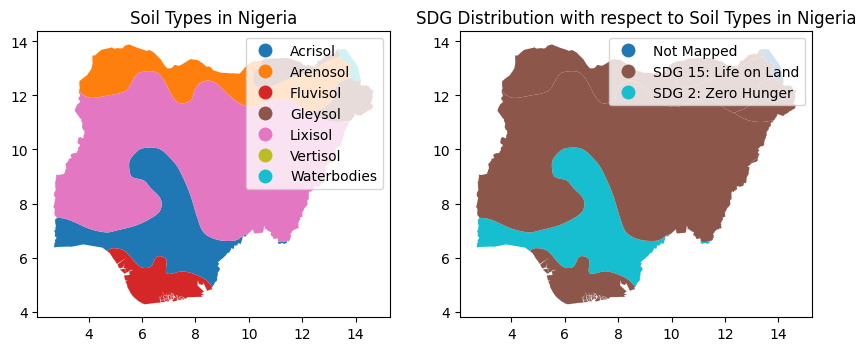

In [54]:
fig, (ax1,ax2) = plt.subplots(1,2, figsize = (10,10))
# Plot the mapped_soil data
Mapped_Soil.plot(ax = ax1, column='IPCC', legend=True)
ax1.set_title("Soil Types in Nigeria")
Mapped_Soil.plot(ax = ax2, column='SDG_Mapping', legend=True)
ax2.set_title("SDG Distribution with respect to Soil Types in Nigeria")

plt.show()


In [51]:
from plotly.offline import init_notebook_mode
init_notebook_mode(connected=True)


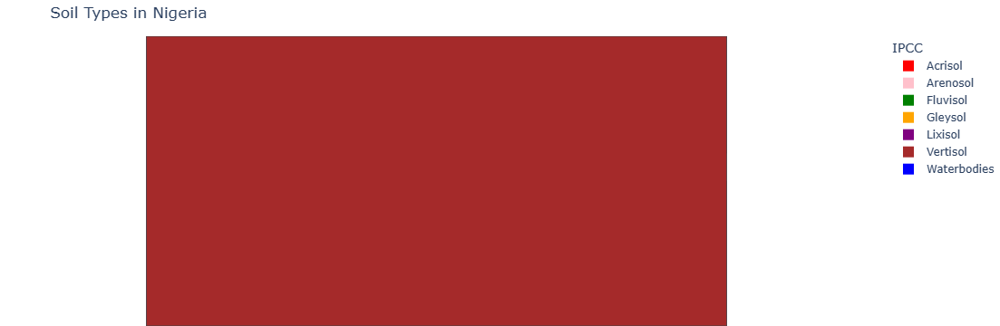

In [26]:

color_discrete_map = {
    'Acrisol': 'red',
    'Arenosol': 'pink',
    'Fluvisol': 'green',
    'Gleysol': 'Orange',
    'Lixisol':'Purple',
    'Vertisol':'Brown',
    'Waterbodies':'Blue'
}

# Create a choropleth map with the color mapping
fig = px.choropleth(Mapped_Soil,
                    geojson=Mapped_Soil.geometry,
                    locations='mg_code',
                    color='IPCC',
                    color_discrete_map=color_discrete_map,  # Manually define color mapping
                    hover_name='IPCC',
                    title="Soil Types in Nigeria")

# Customize the map layout
fig.update_geos(fitbounds="locations", visible=False)
fig.update_layout(margin={"r": 0, "t": 40, "l": 0, "b": 0})

# Display the map
fig.show()



# Barchat depiciting Frequency of Soil Types

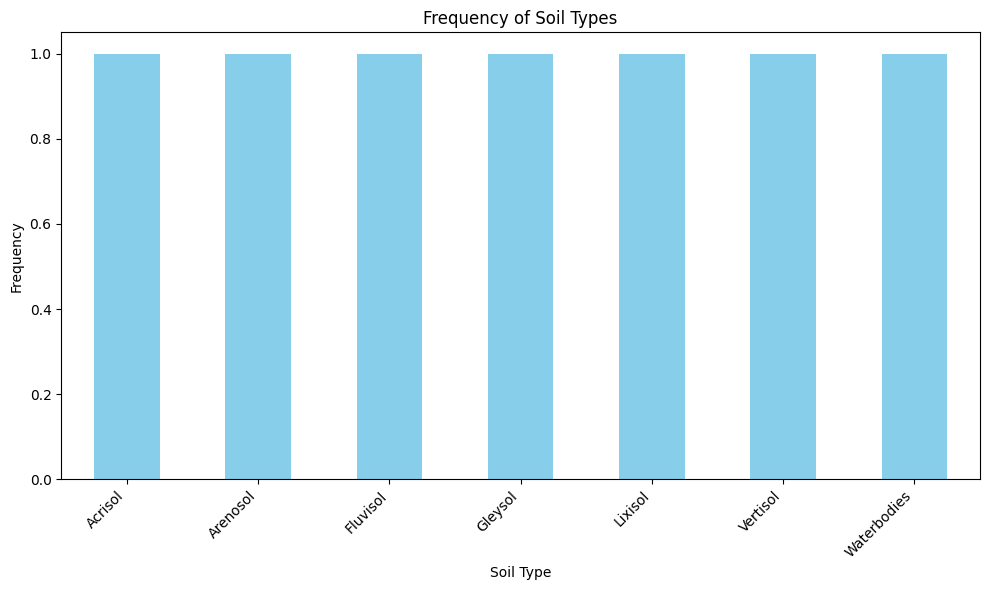

In [30]:


# Group the data by soil type and count the occurrences
soil_type_counts = Mapped_Soil['IPCC'].value_counts()

# Create a bar chart
plt.figure(figsize=(10, 6))
soil_type_counts.plot(kind='bar', color='skyblue')
plt.title("Frequency of Soil Types")
plt.xlabel("Soil Type")
plt.ylabel("Frequency")
plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for better readability
plt.tight_layout()

# Show the bar chart
plt.show()


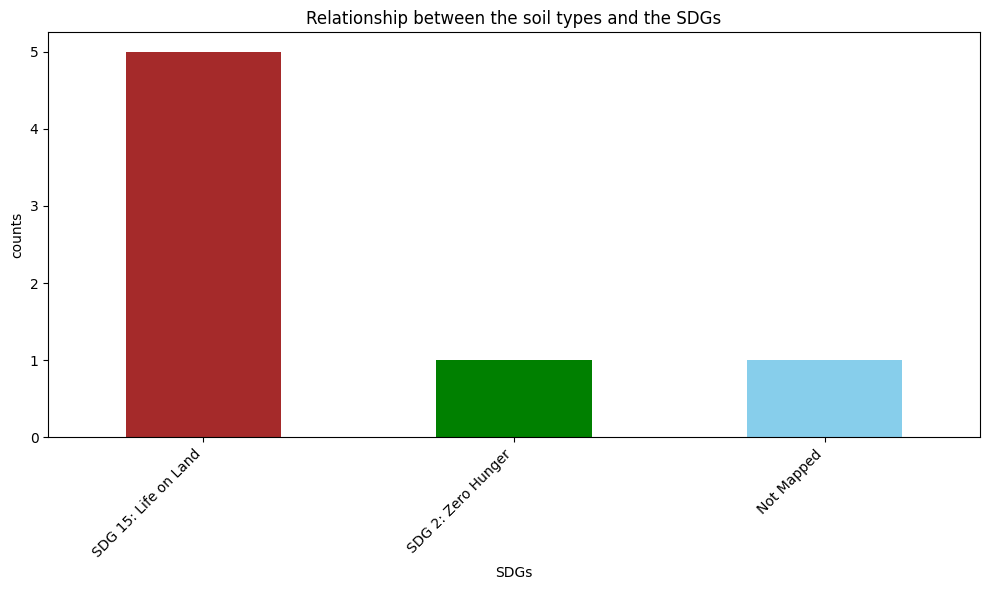

In [37]:
# Group the data by soil type and count the occurrences
soil_type_counts = Mapped_Soil['SDG_Mapping'].value_counts()

# Create a bar chart
plt.figure(figsize=(10, 6))
soil_type_counts.plot(kind='bar', color=['brown','green', 'skyblue'])
plt.title("Relationship between the soil types and the SDGs")
plt.xlabel("SDGs")
plt.ylabel("counts")
plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for better readability
plt.tight_layout()

# Show the bar chart
plt.show()

# Heatmap of Soil Types and SDG Mapping

The heatmap will be generated from the Mapped_Soil data, which will relates soil types to Sustainable Development Goals (SDG) mapping categories. This is to provide a visual representation of the distribution and relationships between different soil types and their alignment with specific SDG goals

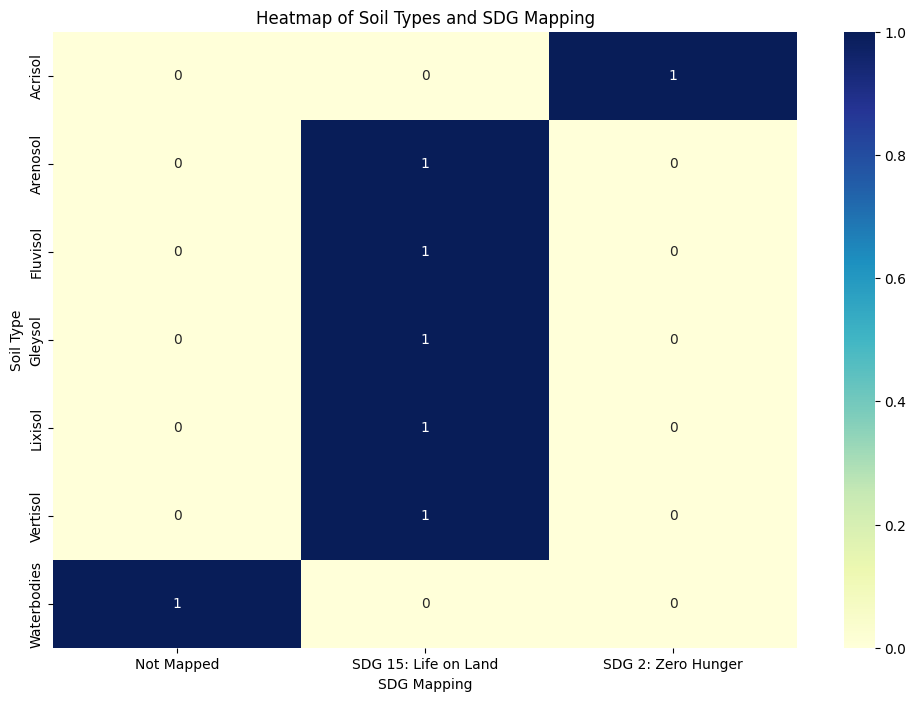

In [39]:

# Pivot the data to create a heatmap
heatmap_data = Mapped_Soil.pivot_table(index='IPCC', columns='SDG_Mapping', aggfunc='size', fill_value=0)

# Create the heatmap
plt.figure(figsize=(12, 8))
sns.heatmap(heatmap_data, cmap='YlGnBu', annot=True, fmt='d', cbar=True)
plt.title("Heatmap of Soil Types and SDG Mapping")
plt.xlabel("SDG Mapping")
plt.ylabel("Soil Type")

# Show the heatmap
plt.show()


In [40]:
heatmap_data

SDG_Mapping,Not Mapped,SDG 15: Life on Land,SDG 2: Zero Hunger
IPCC,,,
Acrisol,0,0,1
Arenosol,0,1,0
Fluvisol,0,1,0
Gleysol,0,1,0
Lixisol,0,1,0
Vertisol,0,1,0
Waterbodies,1,0,0


Acrisol Soil Type: Acrisol soil type is associated with SDG 2: Zero Hunger, indicating that this soil type might be more common in areas where achieving food security is a priority. It is not mapped to SDG 15: Life on Land, suggesting that it may not be prevalent in areas where this goal is emphasized.

Arenosol, Fluvisol, Gleysol, and Lixisol Soil Types: These soil types are all associated with SDG 15: Life on Land, which suggests that they might be more frequently found in regions where land and ecosystem sustainability are significant concerns. None of them are mapped to SDG 2: Zero Hunger, indicating that they may not be the primary soil types in areas prioritizing food security.

Vertisol Soil Type: Similar to the previous soil types, Vertisol is associated with SDG 15: Life on Land. It is not mapped to SDG 2: Zero Hunger, indicating that it may not be the dominant soil type in regions with a focus on food security.


# Box Plot of Soil Types by SDG Mapping

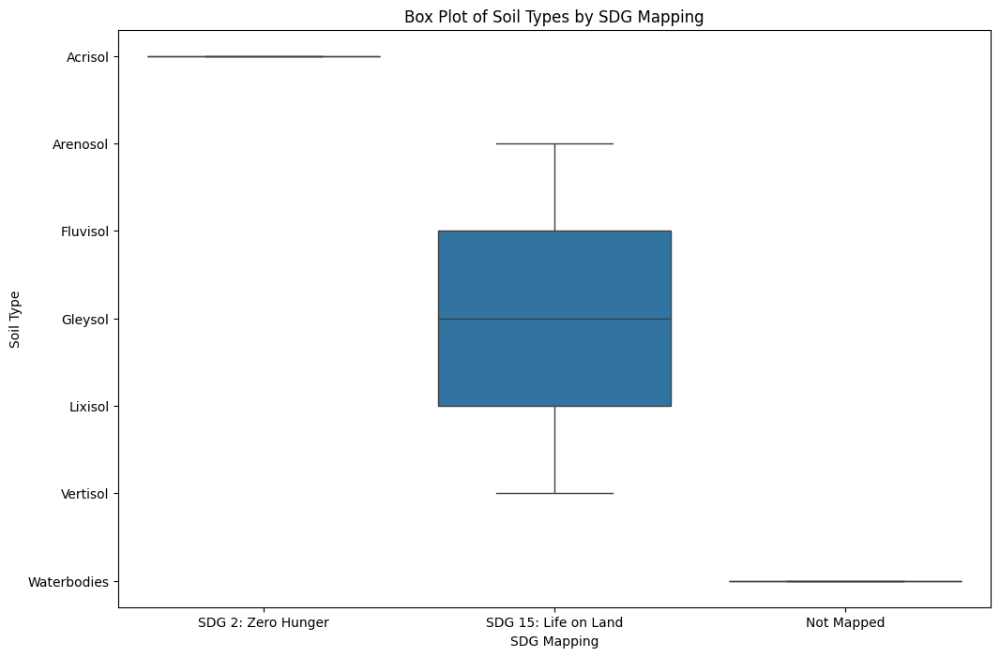

In [43]:

# Create a box plot
plt.figure(figsize=(12, 8))
sns.boxplot(x='SDG_Mapping', y='IPCC', data=Mapped_Soil)
plt.title("Box Plot of Soil Types by SDG Mapping")
plt.xlabel("SDG Mapping")
plt.ylabel("Soil Type")

# Show the box plot
plt.show()


The Box plot provide insights into the central tendency, spread, and presence of potential outliers in the data, making it easier to compare the characteristics of soil types with respect to SDG Mapping.

# MAPPED CLIMATE 

In [158]:
Mapped_Climate = gpd.read_file(r'C:\Users\user\AppData\Local\Programs\Mapped_Nigeria_IPCC_ClimateZoneMap.geojson')
Mapped_Climate

,CLASS_NAME,SDG_Mapping,geometry
0,9,SDG 6: Clean Water and Sanitation,"POLYGON ((11.60000 7.60000, 11.60000 7.50000, ..."
1,9,SDG 6: Clean Water and Sanitation,"POLYGON ((11.90000 8.35000, 11.90000 8.15000, ..."
2,9,SDG 6: Clean Water and Sanitation,"POLYGON ((12.00000 8.40000, 12.00000 8.35000, ..."
3,9,SDG 6: Clean Water and Sanitation,"POLYGON ((11.85000 8.60000, 11.85000 8.40000, ..."
4,9,SDG 6: Clean Water and Sanitation,"POLYGON ((12.50000 8.65000, 12.60000 8.65000, ..."
5,11,Not Mapped,"MULTIPOLYGON (((3.75000 11.35000, 3.75000 11.2..."
6,10,Not Mapped,"MULTIPOLYGON (((8.30952 4.60000, 8.30931 4.600..."
7,0,Not Mapped,"MULTIPOLYGON (((2.75000 6.40000, 3.05172 6.400..."
8,0,Not Mapped,"MULTIPOLYGON (((8.25000 4.84891, 8.25236 4.846..."
9,10,Not Mapped,"POLYGON ((9.40000 6.40000, 9.40000 6.50000, 9...."


# Basic map plot

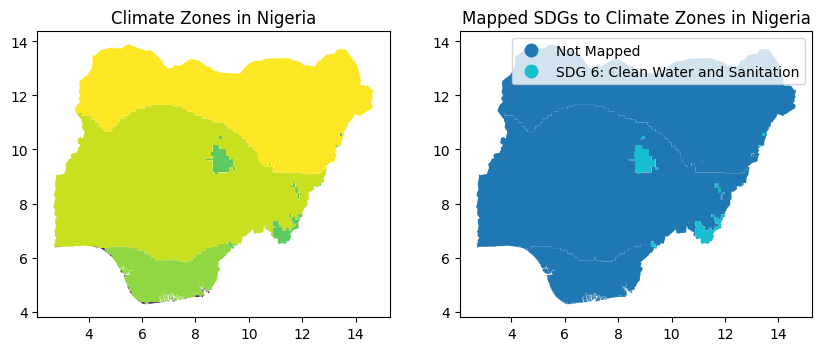

In [56]:
fig, (ax1,ax2) = plt.subplots(1,2, figsize = (10,10))
Mapped_Climate.plot(ax = ax1, column='CLASS_NAME')
ax1.set_title("Climate Zones in Nigeria")

Mapped_Climate.plot(ax = ax2, column='SDG_Mapping', legend=True)
ax2.set_title("Mapped SDGs to Climate Zones in Nigeria")
plt.show()

# Bar chart representing the mapped relationships between mapped_climate and SDGs 

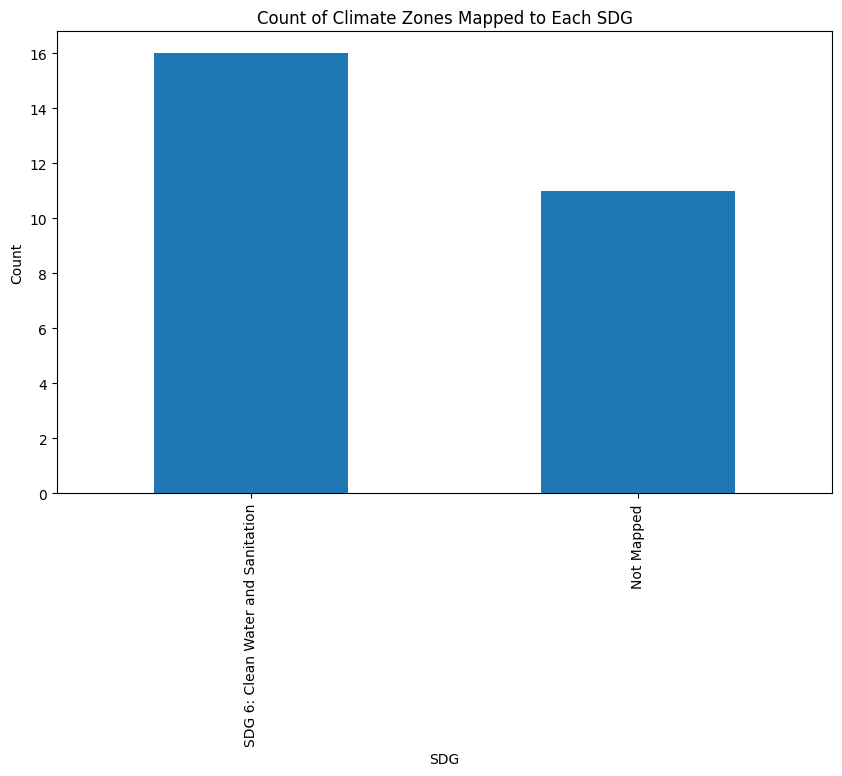

In [57]:

# Count the occurrences of each SDG in the dataset
sdg_counts = Mapped_Climate['SDG_Mapping'].value_counts()

# Create a bar plot
plt.figure(figsize=(10, 6))
sdg_counts.plot(kind='bar')
plt.xlabel('SDG')
plt.ylabel('Count')
plt.title('Count of Climate Zones Mapped to Each SDG')
plt.show()


In this visualization, tThe highest number of climate zones are mapped to SDG 6, which is related to "Clean Water and Sanitation.

SDG 6 has a significantly higher number of climate zones compared to other SDGs.
Other SDGs have relatively fewer climate zones mapped to them, indicating a more focused relationship."

# Pie Chart depicting mapped relationships between mapped_climate and SDGs 

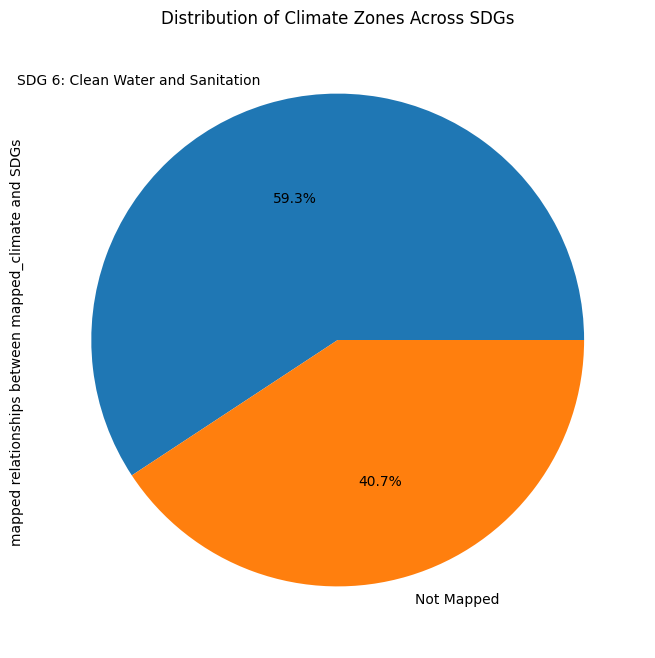

In [58]:
# Create a pie chart
plt.figure(figsize=(8, 8))
sdg_counts.plot(kind='pie', autopct='%1.1f%%')
plt.title('Distribution of Climate Zones Across SDGs')
plt.ylabel('mapped relationships between mapped_climate and SDGs ')  
plt.show()


This pie chart illustrates the distribution of climate zones across different SDGs.
SDG 6, "Clean Water and Sanitation," dominates the distribution with a substantial portion of the climate zones.
SDG 6 represents the largest share of climate zones, indicating its prominence in the dataset.
Other SDGs have smaller portions, emphasizing their relative importance.

# Stacked Bar Plot (Climate Zones Mapped to SDGs)

<Figure size 1200x600 with 0 Axes>

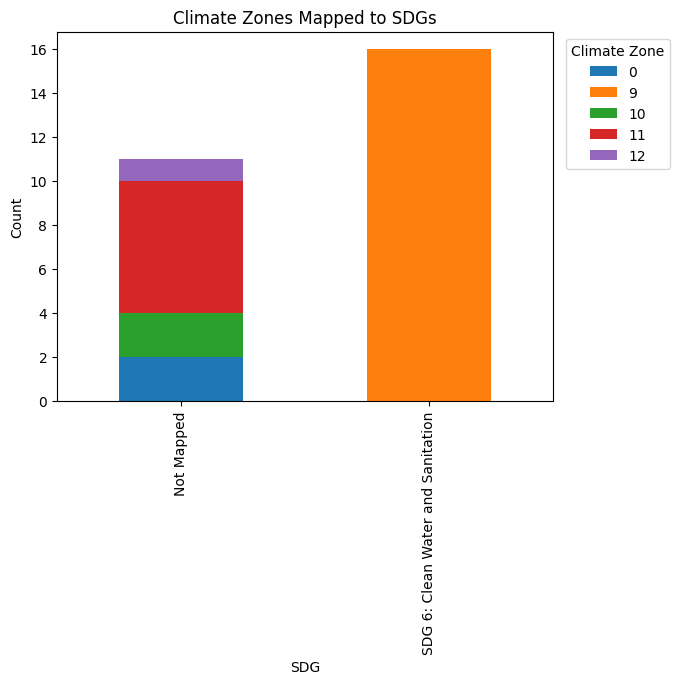

In [61]:
# Create a crosstab to count climate zones for each SDG
ct = pd.crosstab(Mapped_Climate['SDG_Mapping'], Mapped_Climate['CLASS_NAME'])

# Create a stacked bar plot
plt.figure(figsize=(12, 6))
ct.plot(kind='bar', stacked=True)
plt.xlabel('SDG')
plt.ylabel('Count')
plt.title('Climate Zones Mapped to SDGs')
plt.legend(title='Climate Zone', loc='upper right', bbox_to_anchor=(1.25, 1))
plt.show()


# Heat map

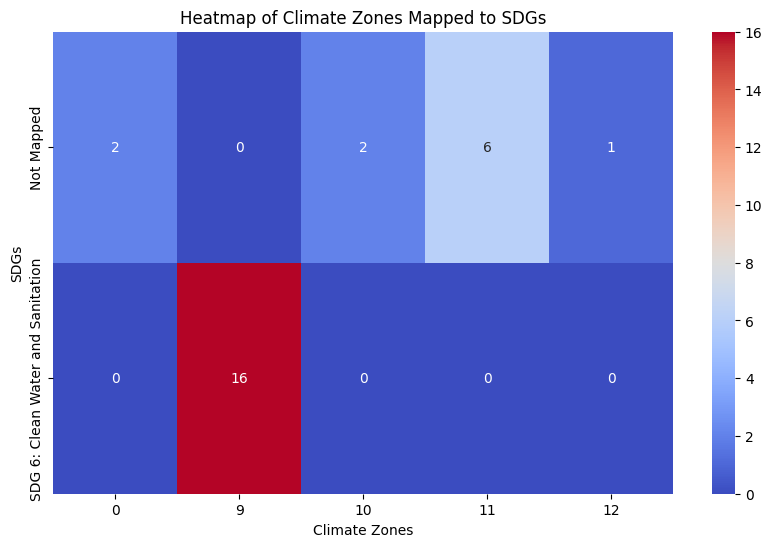

In [62]:


# Create a pivot table to prepare data for the heatmap
heatmap_data = Mapped_Climate.pivot_table(index='SDG_Mapping', columns='CLASS_NAME', aggfunc='size', fill_value=0)

# Create a heatmap
plt.figure(figsize=(10, 6))
sns.heatmap(heatmap_data, cmap='coolwarm', annot=True, fmt='d', cbar=True)
plt.xlabel('Climate Zones')
plt.ylabel('SDGs')
plt.title('Heatmap of Climate Zones Mapped to SDGs')
plt.show()


In [63]:
heatmap_data

CLASS_NAME,0,9,10,11,12
SDG_Mapping,,,,,
Not Mapped,2,0,2,6,1
SDG 6: Clean Water and Sanitation,0,16,0,0,0


The "Not Mapped" SDG Mapping category has a relatively high correlation with Climate Zones classified as "11" (SDG 11) and "11" (SDG 12)
The "SDG 6: Clean Water and Sanitation" category has a strong association with Climate Zones classified as "9" 

The heat map generated highlights that climate zone 9 (Tropical Montane) has strong associations with SDG 6 (Clean Water and Sanitation), while others are not explicitly mapped to any SDG, indicating areas with specific thematic foci. It also shows that most climate zones are not associated with multiple SDGs, which could be valuable information for targeted sustainability efforts and planning.

# Tree Map

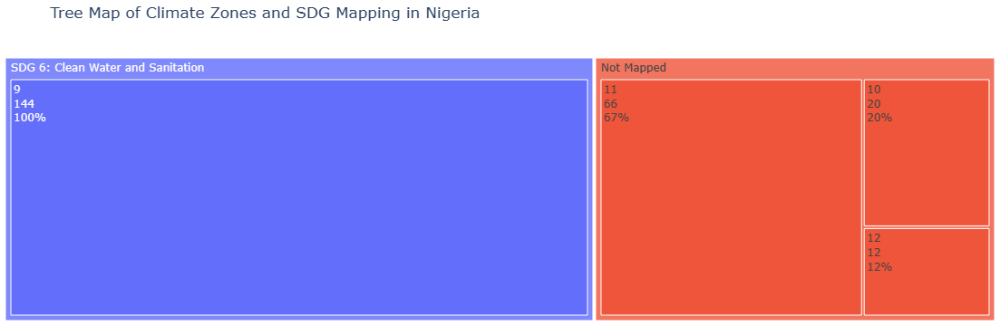

In [64]:

# Create a tree map
fig = px.treemap(Mapped_Climate, 
                 path=['SDG_Mapping', 'CLASS_NAME'], 
                 values='CLASS_NAME',  # You can use any numerical column for values
                 title="Tree Map of Climate Zones and SDG Mapping in Nigeria")

# Customize the appearance of the tree map
fig.update_traces(textinfo="label+value+percent parent")
fig.update_layout(margin={"r":0,"t":40,"l":0,"b":0})

# Display the tree map
fig.show()


This tree map allows us to visualize the hierarchical relationship between climate zones and SDG_mapping in Nigeria, making it easier to see the distribution and relationships between different categories.

# Overlay Mapped_Climate and Mapped_Soil

C:\Users\user\AppData\Local\Temp\ipykernel_8816\2926227116.py:11: UserWarning:

Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.




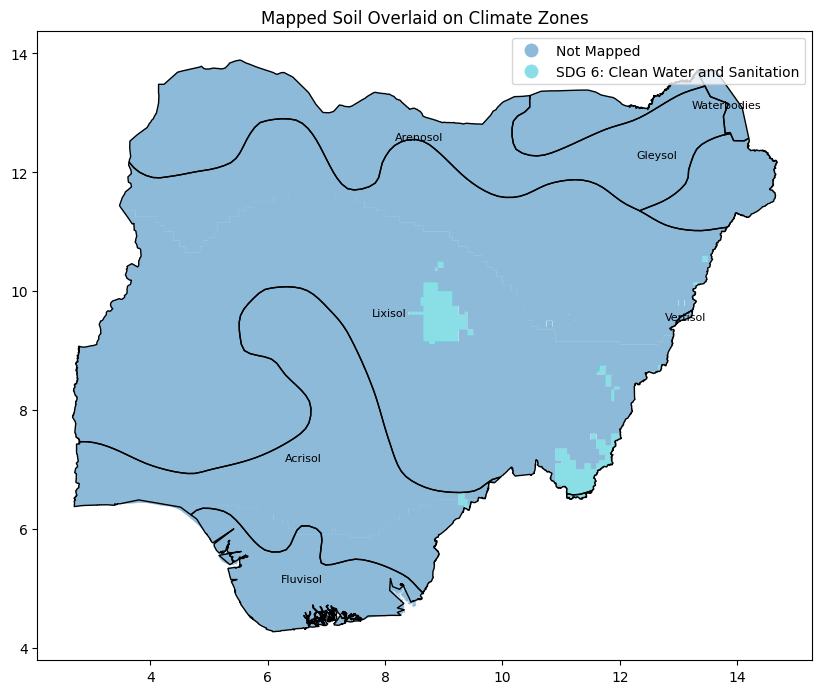

In [135]:
# Create a single plot
fig, ax = plt.subplots(figsize=(10, 10))

# Plot Mapped_Climate first, and specify the colormap (cmap)
Mapped_Climate.plot(ax=ax, column='SDG_Mapping', alpha=0.5, legend=True, legend_kwds={'bbox_to_anchor': (1, 1)}) 

# Overlay Mapped_Soil on top of Mapped_Climate
Mapped_Soil.plot(ax=ax, facecolor = 'none')

# Annotate the map with soil names
for x, y, label in zip(Mapped_Soil.geometry.centroid.x, Mapped_Soil.geometry.centroid.y, Mapped_Soil['IPCC']):
    ax.text(x, y, label, fontsize=8, ha='center', va='center')

# Set the title
ax.set_title("Mapped Soil Overlaid on Climate Zones")

# Display the map
plt.show()

# Heatmap of Climate Zones and Soil Types Based on SDG Mapping

In [136]:
#Heat map of Mapped_climate overlaid on Mapped_
# Prepare the data
combined_data = Mapped_Climate.merge(Mapped_Soil, on='SDG_Mapping', how='outer')
heatmap_data = combined_data.pivot_table(index='CLASS_NAME', columns='IPCC', values='mg_code', aggfunc='count', fill_value=0)


combined_data

,CLASS_NAME,SDG_Mapping,geometry_x,country,ISO3166_2,name,SNAME,mg_code,IPCC,adminlevel,geometry_y
0,9.0,SDG 6: Clean Water and Sanitation,"POLYGON ((11.60000 7.60000, 11.60000 7.50000, ...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,None
1,9.0,SDG 6: Clean Water and Sanitation,"POLYGON ((11.90000 8.35000, 11.90000 8.15000, ...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,None
2,9.0,SDG 6: Clean Water and Sanitation,"POLYGON ((12.00000 8.40000, 12.00000 8.35000, ...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,None
3,9.0,SDG 6: Clean Water and Sanitation,"POLYGON ((11.85000 8.60000, 11.85000 8.40000, ...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,None
4,9.0,SDG 6: Clean Water and Sanitation,"POLYGON ((12.50000 8.65000, 12.60000 8.65000, ...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,None
5,9.0,SDG 6: Clean Water and Sanitation,"POLYGON ((11.00000 6.75000, 10.91354 6.75000, ...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,None
6,9.0,SDG 6: Clean Water and Sanitation,"POLYGON ((10.48903 6.90000, 10.48894 6.89994, ...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,None
7,9.0,SDG 6: Clean Water and Sanitation,"POLYGON ((11.75000 8.75000, 11.75000 8.60000, ...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,None
8,9.0,SDG 6: Clean Water and Sanitation,"POLYGON ((12.65000 8.65000, 12.65000 8.75000, ...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,None
9,9.0,SDG 6: Clean Water and Sanitation,"POLYGON ((13.25000 10.10000, 13.25000 10.15000...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,None


In [137]:
heatmap_data

IPCC,Waterbodies
CLASS_NAME,
0.0,2
10.0,2
11.0,6
12.0,1


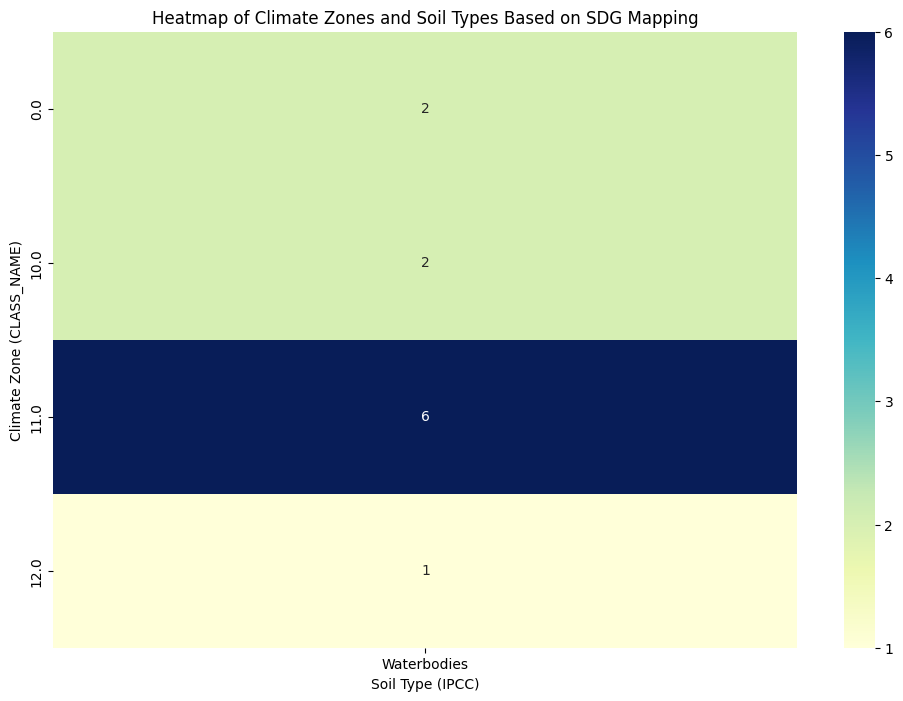

In [138]:
# Create the heatmap
plt.figure(figsize=(12, 8))
sns.heatmap(heatmap_data, cmap='YlGnBu', annot=True, fmt='d', cbar=True)
plt.title("Heatmap of Climate Zones and Soil Types Based on SDG Mapping")
plt.xlabel("Soil Type (IPCC)")
plt.ylabel("Climate Zone (CLASS_NAME)")

# Show the heatmap
plt.show()

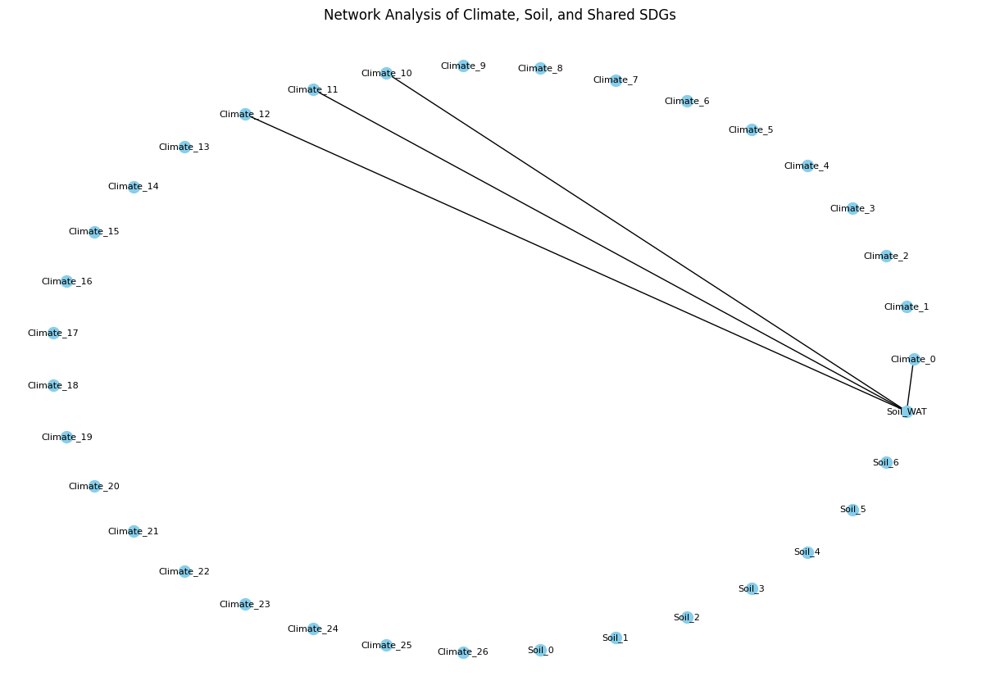

In [104]:
import networkx as nx
import matplotlib.pyplot as plt

# Create a network graph
G = nx.Graph()

# Add nodes for Mapped_Climate, Mapped_Soil, and their respective SDGs
climate_nodes = ["Climate_" + str(i) for i in range(len(Mapped_Climate))]
soil_nodes = ["Soil_" + str(i) for i in range(len(Mapped_Soil))]

G.add_nodes_from(climate_nodes)
G.add_nodes_from(soil_nodes)

# Add edges to represent relationships based on shared SDGs
for climate_node in Mapped_Climate.iterrows():
    for soil_node in Mapped_Soil.iterrows():
        if climate_node[1]['SDG_Mapping'] == soil_node[1]['SDG_Mapping']:
            G.add_edge(f"Climate_{climate_node[1]['CLASS_NAME']}", f"Soil_{soil_node[1]['SNAME']}")

# Create a network layout
pos = nx.circular_layout(G)

# Plot the network graph
plt.figure(figsize=(12, 8))
nx.draw(G, pos, with_labels=True, node_size=100, node_color='skyblue', font_size=8, font_color='black')
plt.title("Network Analysis of Climate, Soil, and Shared SDGs")
plt.axis('off')
plt.show()


By examining the graph, we can see which climate zones and soil types are linked by shared SDGs. This can help you understand the relationships and dependencies between environmental factors (climate and soil) and sustainable development goals.

In [97]:
density = nx.density(G)
print ('The edge density is ' + str(density))

The edge density is 0.0067226890756302525


The edge density value helps you understand the level of connectedness and commonality between different nodes (climate zones and soil types) in your network graph based on shared SDGs. 

A low edge density value (0.0067) indicates that there are relatively few relationships (edges) between climate zones and soil types based on shared SDGs. This suggests that most climate zones and soil types do not share SDGs

In [110]:
degree_centrality = nx.degree_centrality(G)
degree_centrality

{'Climate_0': 0.029411764705882353,
 'Climate_1': 0.0,
 'Climate_2': 0.0,
 'Climate_3': 0.0,
 'Climate_4': 0.0,
 'Climate_5': 0.0,
 'Climate_6': 0.0,
 'Climate_7': 0.0,
 'Climate_8': 0.0,
 'Climate_9': 0.0,
 'Climate_10': 0.029411764705882353,
 'Climate_11': 0.029411764705882353,
 'Climate_12': 0.029411764705882353,
 'Climate_13': 0.0,
 'Climate_14': 0.0,
 'Climate_15': 0.0,
 'Climate_16': 0.0,
 'Climate_17': 0.0,
 'Climate_18': 0.0,
 'Climate_19': 0.0,
 'Climate_20': 0.0,
 'Climate_21': 0.0,
 'Climate_22': 0.0,
 'Climate_23': 0.0,
 'Climate_24': 0.0,
 'Climate_25': 0.0,
 'Climate_26': 0.0,
 'Soil_0': 0.0,
 'Soil_1': 0.0,
 'Soil_2': 0.0,
 'Soil_3': 0.0,
 'Soil_4': 0.0,
 'Soil_5': 0.0,
 'Soil_6': 0.0,
 'Soil_WAT': 0.11764705882352941}

In [111]:
closeness_centrality = nx.closeness_centrality(G)
closeness_centrality

{'Climate_0': 0.06722689075630252,
 'Climate_1': 0.0,
 'Climate_2': 0.0,
 'Climate_3': 0.0,
 'Climate_4': 0.0,
 'Climate_5': 0.0,
 'Climate_6': 0.0,
 'Climate_7': 0.0,
 'Climate_8': 0.0,
 'Climate_9': 0.0,
 'Climate_10': 0.06722689075630252,
 'Climate_11': 0.06722689075630252,
 'Climate_12': 0.06722689075630252,
 'Climate_13': 0.0,
 'Climate_14': 0.0,
 'Climate_15': 0.0,
 'Climate_16': 0.0,
 'Climate_17': 0.0,
 'Climate_18': 0.0,
 'Climate_19': 0.0,
 'Climate_20': 0.0,
 'Climate_21': 0.0,
 'Climate_22': 0.0,
 'Climate_23': 0.0,
 'Climate_24': 0.0,
 'Climate_25': 0.0,
 'Climate_26': 0.0,
 'Soil_0': 0.0,
 'Soil_1': 0.0,
 'Soil_2': 0.0,
 'Soil_3': 0.0,
 'Soil_4': 0.0,
 'Soil_5': 0.0,
 'Soil_6': 0.0,
 'Soil_WAT': 0.11764705882352941}

Degree centrality measures how many connections (edges) a node has relative to all other nodes in the network. In this case, the nodes represent climate zones and soil types, and the edges represent relationships based on shared SDGs.

The degree centrality values for most nodes are 0. This means that the majority of climate zones and soil types in this network have no direct connections (edges) to other nodes based on shared SDGs.

The majority of climate zones and soil types in your dataset have no direct relationships based on shared SDGs. This suggests that most climate zones and soil types have unique or independent relationships with SDGs.




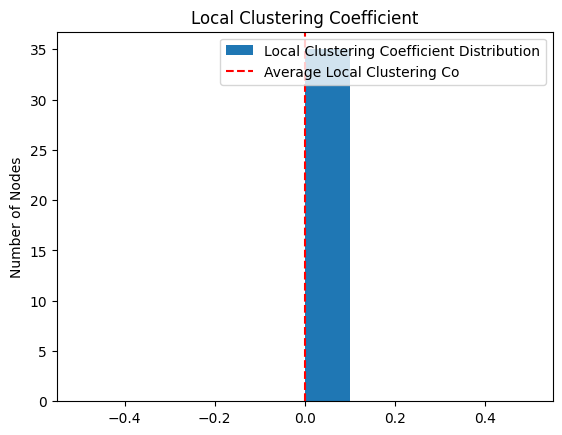

In [100]:
local_clustering = nx.algorithms.cluster.clustering(G)
av_local_clustering = sum(local_clustering.values())/len(local_clustering)

plt.hist(local_clustering.values(), label = 'Local Clustering Coefficient Distribution')
plt.axvline(av_local_clustering, color ='r', linestyle= 'dashed', label = 'Average Local Clustering Co')
plt.legend()
plt.ylabel('Number of Nodes')
plt.title('Local Clustering Coefficient')
plt.show()

In [101]:
local_clustering

{'Climate_0': 0,
 'Climate_1': 0,
 'Climate_2': 0,
 'Climate_3': 0,
 'Climate_4': 0,
 'Climate_5': 0,
 'Climate_6': 0,
 'Climate_7': 0,
 'Climate_8': 0,
 'Climate_9': 0,
 'Climate_10': 0,
 'Climate_11': 0,
 'Climate_12': 0,
 'Climate_13': 0,
 'Climate_14': 0,
 'Climate_15': 0,
 'Climate_16': 0,
 'Climate_17': 0,
 'Climate_18': 0,
 'Climate_19': 0,
 'Climate_20': 0,
 'Climate_21': 0,
 'Climate_22': 0,
 'Climate_23': 0,
 'Climate_24': 0,
 'Climate_25': 0,
 'Climate_26': 0,
 'Soil_0': 0,
 'Soil_1': 0,
 'Soil_2': 0,
 'Soil_3': 0,
 'Soil_4': 0,
 'Soil_5': 0,
 'Soil_6': 0,
 'Soil_WAT': 0}

In [102]:
av_local_clustering

0.0

The result suggests that there is no significant local clustering or community structure in your network graph. In other words, the connections between nodes based on shared SDGs are not forming cohesive clusters or subgroups. This can indicate that the relationships between climate zones, soil types, and SDGs are relatively sparse and do not exhibit strong local clustering patterns.


In [168]:
Mapped_GEZ = gpd.read_file(r'C:\Users\user\AppData\Local\Programs\Mapped_Nigeria_GEZ.geojson')
Mapped_GEZ

,country,ISO3166_2,name,gez_name,gez_code,gez_abbrev,adminlevel,SDG_Mapping,geometry
0,NGA,,Nigeria,Tropical dry forest,13,TAwb,2,SDG 15: life on Land,"POLYGON ((4.17387 12.70964, 3.91224 12.72630, ..."
1,NGA,,Nigeria,Tropical moist forest,12,TAwa,2,SDG 15: life on Land,"POLYGON ((6.12077 12.05414, 6.01167 12.05684, ..."
2,NGA,,Nigeria,Tropical mountain system,16,TM,2,SDG 15: life on Land,"MULTIPOLYGON (((12.00401 7.51347, 12.00703 7.5..."
3,NGA,,Nigeria,Tropical rainforest,11,TAr,2,SDG 15: life on Land,"MULTIPOLYGON (((6.72261 4.40102, 6.72370 4.401..."
4,NGA,,Nigeria,Tropical shrubland,14,TBSh,2,SDG 15: life on Land,"POLYGON ((5.83178 13.76125, 5.78032 13.78030, ..."
5,NGA,,Nigeria,Water,90,Water,2,SDG 14: Life below Water,"POLYGON ((14.19098 12.59410, 14.16116 12.72999..."


In [179]:
import folium

# Create a map centered around Nigeria
m = folium.Map(location=[9.0820, 8.6753], zoom_start=6)

# Define a color mapping based on SDG_Mapping categories
color_mapping = {
    'SDG 15: life on Land': 'green',
    'SDG 14: Life below Water': 'blue',
    # Add more categories and colors as needed
}
m = folium.Map(location=[9.0820, 8.6753], zoom_start=6, )

# Iterate through the GeoDataFrame and add markers to the map
for idx, row in Mapped_GEZ.iterrows():
    sdg_mapping = row['SDG_Mapping']
    color = color_mapping.get(sdg_mapping, 'gray')  # Default to gray if not found in the mapping
    marker = folium.CircleMarker(
        location=[row.geometry.centroid.y, row.geometry.centroid.x],  # Latitude and longitude
        radius=5,
        color=color,
        fill=True,
        fill_color=color,
        fill_opacity=0.6,
        popup=f"<b>{row['gez_name']}</b><br>{row['SDG_Mapping']}",
    )
    marker.add_to(m)


# Save the map to an HTML file
from IPython.display import IFrame

# Save the Folium map as an HTML file
m.save("map.html")

# Embed the HTML file in the Jupyter Notebook
IFrame("map.html", width=800, height=600)


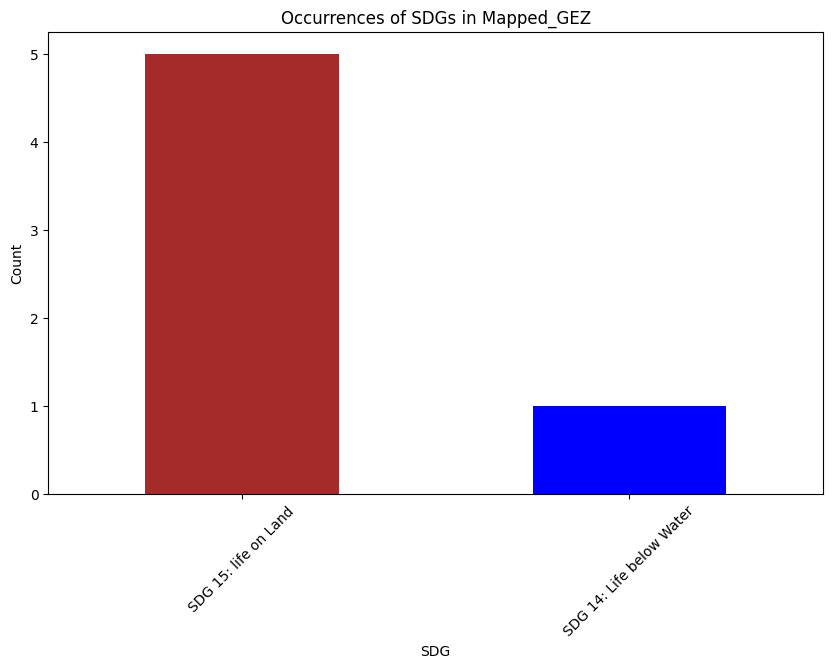

In [186]:

# Count the occurrences of each SDG
sdg_counts = Mapped_GEZ['SDG_Mapping'].value_counts()

# Create a bar chart
plt.figure(figsize=(10, 6))
sdg_counts.plot(kind='bar', color = ['brown','blue'])
plt.title('Occurrences of SDGs in Mapped_GEZ')
plt.xlabel('SDG')
plt.ylabel('Count')
plt.xticks(rotation=45)
plt.show()


In [187]:
sdg_counts

SDG_Mapping
SDG 15: life on Land        5
SDG 14: Life below Water    1
Name: count, dtype: int64

In [193]:
import folium
from folium import Choropleth

# Assuming Mapped_GEZ is a GeoDataFrame with SDG_Mapping column
m = folium.Map(location=[9.0820, 8.6753], zoom_start=6)

# Create a choropleth map based on SDG occurrences
choropleth = Choropleth(
    geo_data=Mapped_GEZ,
    data=Mapped_GEZ,  # Use the GeoDataFrame directly
    columns=['SDG_Mapping', 'SDG_Mapping'],  # Use 'SDG_Mapping' for both data and column specification
    key_on='feature.properties.SDG_Mapping',  # Adapt this to match your data structure
    fill_color='YlGn',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Occurrences of SDGs'
)

choropleth.add_to(m)

# Display the map
m.save('sdg_choropleth_map.html')  # Save to an HTML file


KeyError: 'SDG_Mapping'

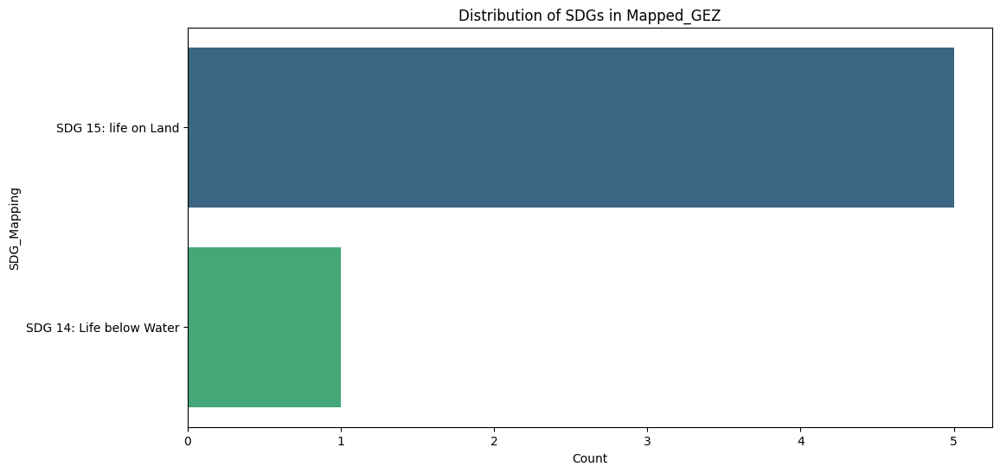

In [198]:
import geopandas as gpd
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming you have a GeoDataFrame called Mapped_GEZ with 'SDG_Mapping' column

# Count the occurrences of each SDG
sdg_counts = Mapped_GEZ['SDG_Mapping'].value_counts().reset_index()
sdg_counts.columns = ['SDG_Mapping', 'Count']

# Create a bar plot to visualize the distribution of SDGs
plt.figure(figsize=(12, 6))
sns.barplot(x='Count', y='SDG_Mapping', data=sdg_counts, hue='SDG_Mapping', palette='viridis', legend=False)
plt.xlabel('Count')
plt.ylabel('SDG_Mapping')

plt.title('Distribution of SDGs in Mapped_GEZ')
plt.show()


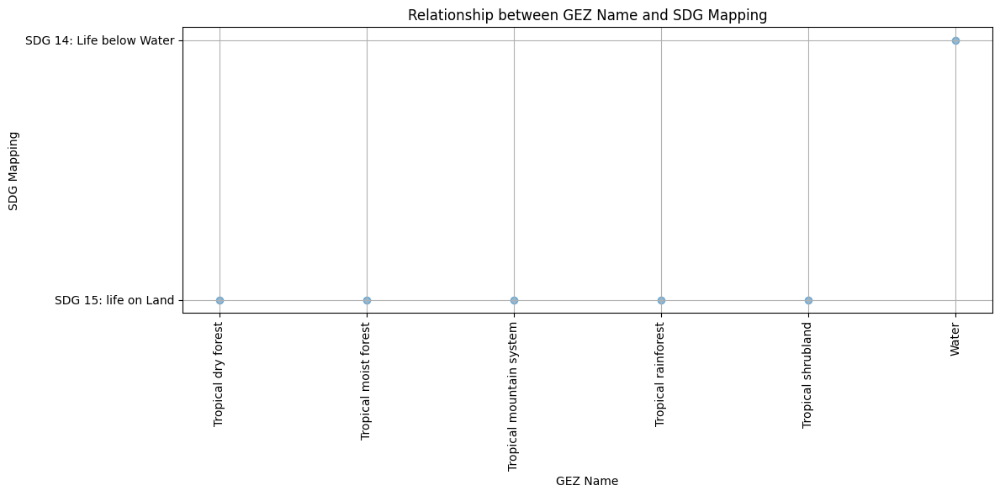

In [199]:
gez_names = Mapped_GEZ['gez_name']
sdg_mappings = Mapped_GEZ['SDG_Mapping']

# Create a scatter plot
plt.figure(figsize=(12, 6))
plt.scatter(gez_names, sdg_mappings, marker='o', alpha=0.5)
plt.xticks(rotation=90)  # Rotate x-axis labels for readability
plt.xlabel('GEZ Name')
plt.ylabel('SDG Mapping')
plt.title('Relationship between GEZ Name and SDG Mapping')
plt.grid(True)

# Show the plot
plt.tight_layout()
plt.show()

In [200]:
gez_names

0         Tropical dry forest
1       Tropical moist forest
2    Tropical mountain system
3         Tropical rainforest
4          Tropical shrubland
5                       Water
Name: gez_name, dtype: object

In [201]:
sdg_mappings

0        SDG 15: life on Land
1        SDG 15: life on Land
2        SDG 15: life on Land
3        SDG 15: life on Land
4        SDG 15: life on Land
5    SDG 14: Life below Water
Name: SDG_Mapping, dtype: object

By observing the points in the scatter plot, we can deduce which SDG mapping is associated with each GEZ name. For example, "Tropical dry forest," "Tropical moist forest," "Tropical mountain system," "Tropical rainforest," and "Tropical shrubland" are primarily associated with "SDG 15: Life on Land," while "Water" is associated with "SDG 14: Life below Water."

The scatter plot allows us to visualize how different GEZ categories are distributed among the available SDG mappings. In this dataset, there is more diversity in GEZ categories under "SDG 15: Life on Land," indicating that "SDG 15: Life on Land" is a broader category.
